# Welcome and Setup

__Welcome to this example notebook of how to train a water segmentation model on Sentinel-1 data.__

Before we get started we need to install some libraries.

In [1]:
!pip install tifffile
!pip install albumentations
!pip install imagecodecs

  Using cached albumentations-1.0.3-py3-none-any.whl (98 kB)
  Using cached opencv_python_headless-4.5.3.56-cp38-cp38-manylinux2014_x86_64.whl (37.1 MB)


# Visualize the data

The dataset consists of 900 [Sentinel 1](https://sentinel.esa.int/web/sentinel/missions/sentinel-1) and coincident [Sentinel 2](https://sentinel.esa.int/web/sentinel/missions/sentinel-2) chips of size 512x512 px together with pixel-wise water labels. 

The scenes are very close in time, but can be up to 3 days apart. Hence, the water labels can also be slightly different.

In [2]:
import numpy as np
import glob
import tifffile
import matplotlib.pyplot as plt

Sentinel-1 performs synthetic aperture radar (SAR) imaging, enabling it to see in all weather conditions and day and night. To better visualize the bands or channels of Sentinel-1 images we will create a false color composite by treating the two bands and their ratio as red, green and blue channels.

Sentinel-2 uses an multispectral optical sensor that captures reflected light in the visible and infrared spectrum. We are using the shortwave infrared, near infrared, and green composite which is great for spotting water. You can find out more about false color composites [here](https://earthobservatory.nasa.gov/features/FalseColor).

Helper functions for visualizations:

In [3]:
def visualize_s2_img(s2_channel_paths):
    """
    Calculates and returns a 'SWIR' S2 false color composite ready for visualization.

    Args:
        s2_channel_paths (list of str): Paths to the ['B12', 'B7', 'B4'] bands of a S2 image.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    img = []
    for path in s2_channel_paths:
        img.append(tifffile.imread(path))
    img = np.stack(img, axis=-1)
    return scale_S1_S2_img(img, sentinel=2)

def visualize_s1_img(path_vv, path_vh):
    """
    Calculates and returns a S1 false color composite ready for visualization.

    Args:
        path_vv (str): Path to the VV band.
        path_vh (str): Path to the VH band.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    s1_img = np.stack((tifffile.imread(path_vv), tifffile.imread(path_vh)), axis=-1)

    img = np.zeros((s1_img.shape[0], s1_img.shape[1], 3), dtype=np.float32)
    img[:, :, :2] = s1_img.copy()
    img[:, :, 2] = s1_img[:, :, 0] / s1_img[:, :, 1]
    s1_img = np.nan_to_num(s1_img)
    return scale_S1_S2_img(img, sentinel=1)

def scale_S1_S2_img(matrix, sentinel=2):
    """
    Returns a scaled (H,W,D) image which is more easily visually inspectable. Image is linearly scaled between
    min and max_value of by channel
    
    Args:
        matrix (np.array): (H,W,D) image to be scaled
        sentinel (int, optional): Sentinel 1 or Sentinel 2 image? Determines the min and max values for scalin, defaults to 2.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    w, h, d = matrix.shape
    min_values = np.array([100, 100, 100]) if sentinel == 2 else np.array([-23, -28, 0.2])
    max_values = np.array([3500, 3500, 3500]) if sentinel == 2 else np.array([0, -5, 1])

    matrix = np.reshape(matrix, [w * h, d]).astype(np.float64)
    matrix = (matrix - min_values[None, :]) / (max_values[None, :] - min_values[None, :])
    matrix = np.reshape(matrix, [w, h, d])

    matrix = matrix.clip(0, 1)
    return matrix

__Let's plot some random Sentinel-1 chips, their water labels and corresponding Sentinel-2 images with their water labels.__

chips/dc70be79-da19-47ee-bdee-4614bc46d610/s1/S1A_IW_GRDH_1SDV_20180507T160449_20180507T160514_021800_025A09_6700_04096-07168/LabelWater.tif


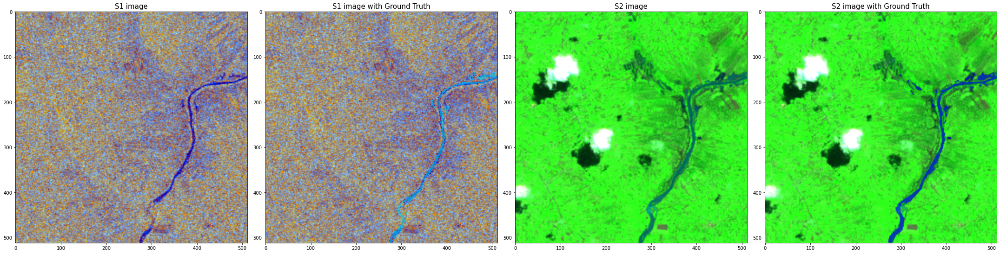

chips/befccce4-79c0-47a2-a43b-a0915486dfa4/s1/S1B_IW_GRDH_1SDV_20181031T091131_20181031T091156_013394_018C70_9265_06862-02469/LabelWater.tif


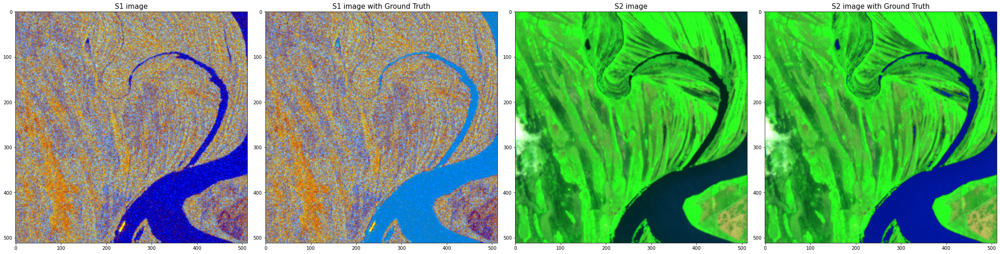

chips/95eff095-c3e9-4c12-bfde-1708b7e19bae/s1/S1B_IW_GRDH_1SDV_20170530T002405_20170530T002430_005820_00A340_2611_02482-05096/LabelWater.tif


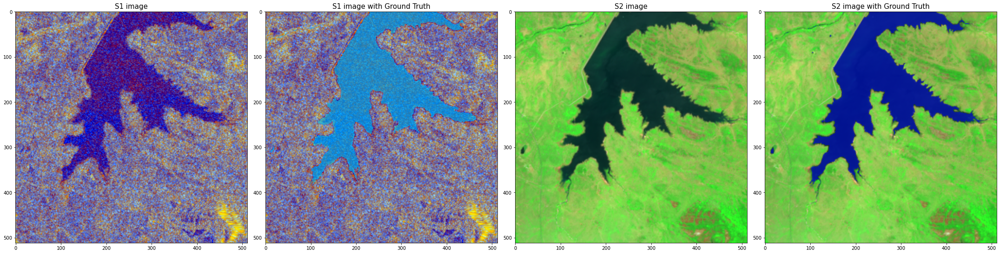

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_02356-01530/LabelWater.tif


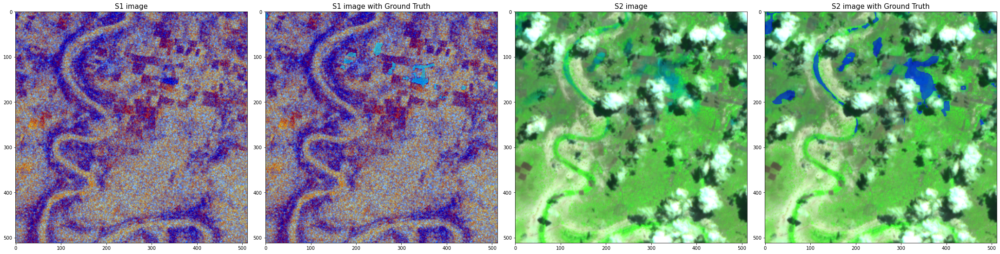

chips/55d43c77-9955-4b4f-b6f0-b21e7f50a039/s1/S1A_IW_GRDH_1SDV_20190404T002124_20190404T002149_026633_02FCE5_A8E7_03584-06144/LabelWater.tif


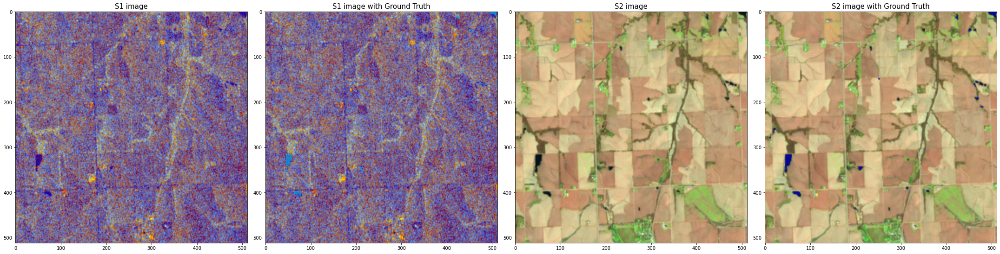

chips/d89b6d2c-ded5-463e-81cc-13c1764df616/s1/S1A_IW_GRDH_1SDV_20160812T234622_20160812T234651_012574_013B43_CFE9_08622-06468/LabelWater.tif


/tmp/ipykernel_2551/2728388163.py:32: RuntimeWarning: invalid value encountered in true_divide
  img[:, :, 2] = s1_img[:, :, 0] / s1_img[:, :, 1]


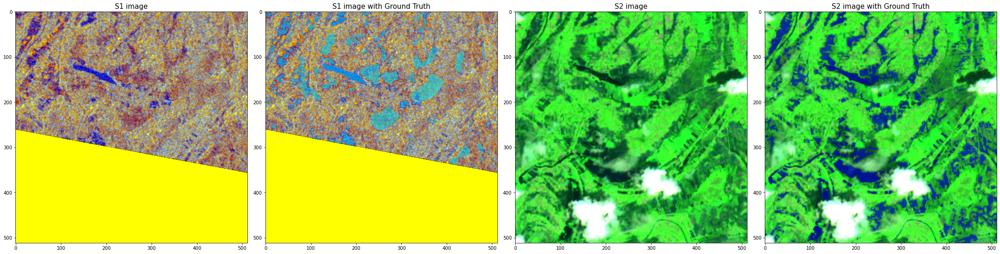

chips/95eff095-c3e9-4c12-bfde-1708b7e19bae/s1/S1B_IW_GRDH_1SDV_20170530T002430_20170530T002501_005820_00A340_FB2A_03506-08828/LabelWater.tif


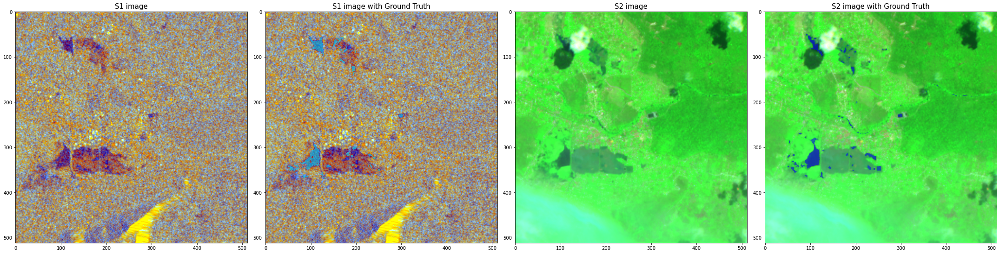

chips/8fcb3e59-7b1b-49c9-92c4-f4ddea14d4e4/s1/S1A_IW_GRDH_1SDV_20200806T043438_20200806T043503_033781_03EA77_63A9_00512-05632/LabelWater.tif


/srv/conda/envs/notebook/lib/python3.8/site-packages/matplotlib/image.py:443: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/srv/conda/envs/notebook/lib/python3.8/site-packages/matplotlib/image.py:444: UserWarning: Warning: converting a masked element to nan.
  vmid = np.float64(self.norm.vmin) + dv / 2


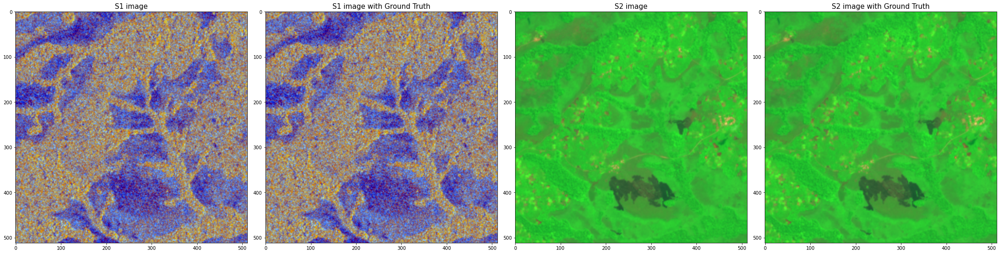

chips/befccce4-79c0-47a2-a43b-a0915486dfa4/s1/S1B_IW_GRDH_1SDV_20181031T091131_20181031T091156_013394_018C70_9265_07340-07051/LabelWater.tif


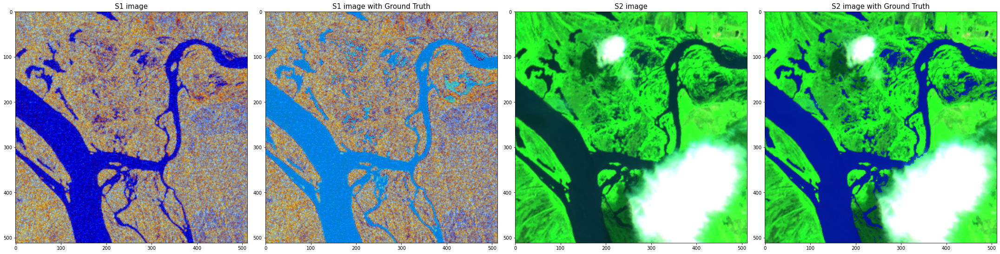

chips/5ef4fb15-6f38-49a8-848a-82ebef8ec6f7/s1/S1B_IW_GRDH_1SDV_20180918T181808_20180918T181833_012773_017943_A930_04771-09311/LabelWater.tif


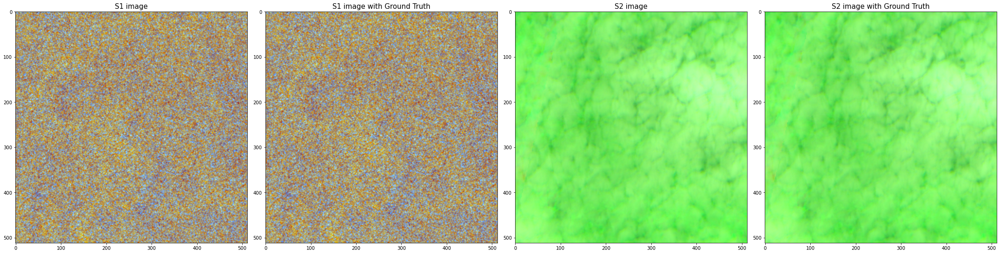

In [4]:
S1_label_paths = sorted(glob.glob("chips/*/s1/*/LabelWater.tif"))

b_channels = ['B12', 'B7', 'B4']
show_how_many = 10
alpha = 0.5

for k in range(show_how_many):
    rand_int = np.random.randint(len(S1_label_paths))
    S1_label_path = S1_label_paths[rand_int]
    S1_VV_path = S1_label_path.replace("LabelWater.tif", "VV.tif")
    S1_VH_path = S1_label_path.replace("LabelWater.tif", "VH.tif")
    
    flood_event = S1_label_path.split("/")[1]
    position = S1_label_path.split("/")[-2].split("_")[-1]
    
    S2_label_path = glob.glob(f"chips/{flood_event}/s2/*{position}/LabelWater.tif")[0]
    S2_bands_paths = [S2_label_path.replace("LabelWater.tif", f"{channel}.tif") for channel in b_channels]
    
    f, axarr = plt.subplots(1, 4, figsize=(30, 10))
    print(S1_label_path)
    s1_img = visualize_s1_img(S1_VV_path, S1_VH_path)
    axarr[0].imshow(s1_img)
    axarr[0].set_title("S1 image", fontsize=15)
    s2_img = visualize_s2_img(S2_bands_paths)
    axarr[1].imshow(s1_img)
    axarr[1].set_title("S1 image with Ground Truth", fontsize=15)
    
    axarr[2].imshow(s2_img)
    axarr[2].set_title("S2 image", fontsize=15)
    axarr[3].imshow(s2_img)
    axarr[3].set_title("S2 image with Ground Truth", fontsize=15)
         
    label = tifffile.imread(S1_label_path)
    label = np.ma.masked_where(label == 0, label)
    axarr[1].imshow(label, cmap="cool", alpha=alpha)
    
    label = tifffile.imread(S2_label_path)
    label = np.ma.masked_where(label == 0, label)
    axarr[3].imshow(label, cmap="winter", alpha=alpha)
    
    plt.tight_layout()
    plt.show()

# Training a Sentinel 1 baseline model with PyTorch

Now, let's train a water segmentation model using only Sentinel-1 data as input.

In [5]:
import torch
import torch.nn as nn
import albumentations
import os
import time
import segmentation_models_pytorch as smp

ModuleNotFoundError: No module named 'torch'

## Split the data into train, validation and test set

We start out with a simple random 70%/15%/15% train, validation and test split.

In [ ]:
train_percentage = 0.7
val_percentage = 0.15
test_percentage = 0.15

S1_label_paths = sorted(glob.glob("chips/*/s1/*/LabelWater.tif"))
S1_img_paths = [[path.replace("LabelWater.tif", "VV.tif"), path.replace("LabelWater.tif", "VH.tif")] for path in S1_label_paths]

np.random.seed(1778)
np.random.shuffle(S1_label_paths)
np.random.seed(1778)
np.random.shuffle(S1_img_paths)

S1_img_paths_train = S1_img_paths[: int(train_percentage * len(S1_img_paths))]
S1_img_paths_val = S1_img_paths[int(train_percentage * len(S1_img_paths)): int((train_percentage + val_percentage) * len(S1_img_paths))]
S1_img_paths_test = S1_img_paths[int((train_percentage + val_percentage) * len(S1_img_paths)):]

S1_label_paths_train = S1_label_paths[: int(train_percentage * len(S1_label_paths))]
S1_label_paths_val = S1_label_paths[int(train_percentage * len(S1_label_paths)): int((train_percentage + val_percentage) * len(S1_label_paths))]
S1_label_paths_test = S1_label_paths[int((train_percentage + val_percentage) * len(S1_label_paths)):]

print(f"Train has {len(S1_img_paths_train)} images and {len(S1_label_paths_train)} labels")
print(f"Val   has {len(S1_img_paths_val)} images and {len(S1_label_paths_val)} labels")
print(f"Test  has {len(S1_img_paths_test)} images and {len(S1_label_paths_test)} labels")

## Create PyTorch datasets and look at some samples

The two channels of Sentinel-1 (VV and VH) are in float32 and have both negative and positive values. We normalize them to lie between 0 and 1 by applying [min-max normalization](https://en.wikipedia.org/wiki/Feature_scaling#Rescaling_.28min-max_normalization.29) with min = -77 and max = 26.

In [ ]:
class Sentinel1_Dataset(torch.utils.data.Dataset):
    def __init__(
        self,
        img_paths,
        mask_paths,
        transforms=None,
        min_normalize=-77,
        max_normalize=26,
    ):
        self.img_paths = img_paths
        self.mask_paths = mask_paths
        self.transforms = transforms
        self.min_normalize = min_normalize
        self.max_normalize = max_normalize

    def __getitem__(self, idx):
        # Load in image
        arr_x = []
        for path in self.img_paths[idx]:
            arr_x.append(tifffile.imread(path))
        arr_x = np.stack(arr_x, axis=-1)

        # Min-Max Normalization
        arr_x = np.clip(arr_x, self.min_normalize, self.max_normalize)
        arr_x = (arr_x - self.min_normalize) / (self.max_normalize - self.min_normalize)

        sample = {"image": arr_x}

        # Load in label mask
        sample["mask"] = tifffile.imread(self.mask_paths[idx])

        # Apply Data Augmentation
        if self.transforms:
            sample = self.transforms(image=sample["image"], mask=sample["mask"])
        if sample["image"].shape[-1] < 20:
            sample["image"] = sample["image"].transpose((2, 0, 1))

        return sample

    def __len__(self):
        return len(self.img_paths)

    def visualize(self, how_many=1, show_specific_index=None):
        for _ in range(how_many):
            rand_int = np.random.randint(len(self.img_paths))
            if show_specific_index is not None:
                rand_int = show_specific_index
            print(self.img_paths[rand_int][0])
            f, axarr = plt.subplots(1, 3, figsize=(30, 9))
            axarr[0].imshow(visualize_s1_img(self.img_paths[rand_int][0], self.img_paths[rand_int][1]))
            sample = self.__getitem__(rand_int)

            img = sample["image"]
            axarr[0].set_title(f"FCC of original S1 image", fontsize=15)
            axarr[1].imshow(img[0]) # Just visualize the VV band here
            axarr[1].set_title(f"VV band returned from the dataset, Min: {img.min():.4f}, Max: {img.max():.4f}", fontsize=15)
            if "mask" in sample.keys():
                axarr[2].set_title(f"Corresponding water mask: {(sample['mask'] == 1).sum()} px", fontsize=15)
                mask = mask_to_img(sample["mask"], {1: (0, 0, 255)})
                axarr[2].imshow(mask)
            plt.tight_layout()
            plt.show()
            
def mask_to_img(label, color_dict):
    """Recodes a (H,W) mask to a (H,W,3) RGB image according to color_dict"""
    mutually_exclusive = np.zeros(label.shape + (3,), dtype=np.uint8)
    for key in range(1, len(color_dict.keys()) + 1):
        mutually_exclusive[label == key] = color_dict[key]
    return mutually_exclusive

To prevent overfitting while training, we apply typical data augmentations like random cropping and random 90 degree rotations, horizontal and vertical flipping.

For validation, we don't apply any data augmentations and just predict on the full 512x512 chips.

In [ ]:
train_crop_size = 256

train_transforms = albumentations.Compose(
    [
        albumentations.RandomCrop(train_crop_size, train_crop_size),
        albumentations.RandomRotate90(),
        albumentations.HorizontalFlip(),
        albumentations.VerticalFlip()
    ]
)

train_dataset = Sentinel1_Dataset(
    S1_img_paths_train,
    S1_label_paths_train,
    transforms=train_transforms,
    min_normalize=-77,
    max_normalize=26,
    )

val_dataset = Sentinel1_Dataset(
    S1_img_paths_val,
    S1_label_paths_val,
    transforms=None,
    min_normalize=-77,
    max_normalize=26,
    )

test_dataset = Sentinel1_Dataset(
    S1_img_paths_test,
    S1_label_paths_test,
    transforms=None,
    min_normalize=-77,
    max_normalize=26,
    )
print(len(train_dataset), len(val_dataset), len(test_dataset))

Let's visualize some examples from the datasets.

In [ ]:
train_dataset.visualize(3)

In [ ]:
val_dataset.visualize(3)

In [ ]:
test_dataset.visualize(3)

## Train a pretrained U-Net segmentation model

We can finally train! Let's prepare the last missing pieces:
- DataLoaders to create training and validation batches of data using multiprocessing
- Loss function
- Validation metric

In [ ]:
num_workers = 2
pin_memory = True

batch_size = 32
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0, pin_memory=pin_memory)

test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0, pin_memory=pin_memory)

For our __loss function__ we choose a standard mixture of 50% cross entropy, 50% dice loss which improves learning in the unbalanced class setting we are in (much more non-water than water).

In [21]:
EPS = 1e-7

class XEDiceLoss(nn.Module):
    """
    Mixture of alpha * CrossEntropy and (1 - alpha) * DiceLoss.
    """
    def __init__(self, alpha=0.5):
        super().__init__()
        self.xe = nn.CrossEntropyLoss()
        self.alpha = alpha

    def forward(self, preds, targets):
        xe_loss = self.xe(preds, targets)
        
        no_ignore = targets.ne(255)
        targets = targets.masked_select(no_ignore)

        preds = torch.softmax(preds, dim=1)[:, 1]
        targets = (targets == 1).float()
        dice_loss = 1 - (2.0 * torch.sum(preds * targets)) / (torch.sum(preds + targets) + EPS)

        return self.alpha * xe_loss + (1 - self.alpha) * dice_loss

    def get_name(self):
        return "XEDiceLoss"

As a starting __validation metric__, we use a global Intersection over Union on the water class. For that, we need to calculate True Positives, False Positives and False Negatives.

In [22]:
def tp_fp_fn(preds, targets):
    tp = torch.sum(preds * targets)
    fp = torch.sum(preds) - tp
    fn = torch.sum(targets) - tp
    return tp.item(), fp.item(), fn.item()

The `AverageMeter` utility class allows us to track various metrics over training.

In [23]:
class AverageMeter(object):
    """
    Computes and stores the average and current value
    Adapted from https://github.com/pytorch/examples/blob/master/imagenet/main.py
    """

    def __init__(self):
        self.reset()

    def reset(self):
        self.val, self.avg, self.sum, self.count = 0, 0, 0, 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

__Training our first model__

Our hyperparameters for this training run:
- `experiment_name = "Exp3"` --> Name for this experiment. Best model weights will be saved in "trained_models/`experiment_name`".
- `backbone = "resnet34"` --> We are using the [smp](https://github.com/qubvel/segmentation_models.pytorch) library to initialize a [U-Net](https://arxiv.org/abs/1505.04597) model. Here, we are using a [ResNet34](https://arxiv.org/abs/1512.03385) pretrained on ImageNet as the encoder of the U-Net.
- `patience = 4` --> Reducing the learning rate after training for a while improves the performance most of the time. Here, we are the strategy of dividing the current learning rate in half after the validation IoU has not increased for 4 epochs using the [ReduceLROnPlateau](https://pytorch.org/docs/stable/generated/torch.optim.lr_scheduler.ReduceLROnPlateau.html) learning rate scheduler in PyTorch.
- `n_epochs = 1000` --> How long to train? Similar to our strategy of reducing the learning rate, we are stopping the training run when the validation IoU has not increased since three times the patience. The maximum number of epochs to train `n_epochs` can therefore be set to a very high number, because the training will surely end before reaching this high number. But it can be set to a very low number to test things out.
- `lr = 1e-3` --> We are using the [Adam](https://pytorch.org/docs/stable/generated/torch.optim.Adam.html#torch.optim.Adam) optimizer which is a good choice, because it is quite robust to various choices of learning rates. The default learning rate is 1e-3 for most libraries.

In [24]:
experiment_name = "Exp3"
on_gpu = torch.cuda.is_available()

backbone = "resnet34"
patience = 4
n_epochs = 1000
lr = 1e-3

In [25]:
early_patience = patience * 3
log_path = f"trained_models/{experiment_name}"
os.makedirs(log_path, exist_ok=True)

model = smp.Unet(
    encoder_name=backbone,
    encoder_weights="imagenet",
    in_channels=2,
    classes=2,
)

loss_func = XEDiceLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode="max",
    factor=0.5,
    patience=patience,
    verbose=True,
)

if on_gpu:
    model = model.cuda()

Let's start the training!
- We are tracking the average time it takes for the dataloader to yield us the next batch of data in `data_time`. If this is too high, we should improve our preprocessing speed or our usage of multiprocessing.
- We are tracking the average time it takes to complete a training/validation step in `batch_time`.

In [26]:
save_dict = {"model_name": experiment_name}
best_metric, best_metric_epoch, early_stopping_metric = 0, 0, 0
early_stop_counter, best_val_early_stopping_metric = 0, 0
early_stop_flag, start_time = False, time.time()

for curr_epoch_num in range(1, n_epochs):
    ## Part 1: Training loop with Model weights updating
    model.train()
    torch.set_grad_enabled(True)

    losses, batch_time, data_time = AverageMeter(), AverageMeter(), AverageMeter()
    end = time.time()
    for iter_num, data in enumerate(train_loader):
        data_time.update(time.time() - end)
        x_data = data["image"]
        targets = data["mask"].long()
        if on_gpu:
            x_data, targets = x_data.cuda(non_blocking=True), targets.cuda(non_blocking=True)

        optimizer.zero_grad()

        preds = model(x_data)
        loss = loss_func(preds, targets)
        loss.backward()
        optimizer.step()

        losses.update(loss.detach().item(), x_data.size(0))

        batch_time.update(time.time() - end)
        end = time.time()

    print(f"Ep: [{curr_epoch_num}] TotalT: {(time.time() - start_time) / 60:.1f} min"
          f", BatchT: {batch_time.avg:.3f}s, DataT: {data_time.avg:.3f}s, Loss: {losses.avg:.4f}")

    ## Part 2: Validation loop to get the current IoU
    model.eval()
    torch.set_grad_enabled(False)

    batch_time, data_time, losses = AverageMeter(), AverageMeter(), AverageMeter()
    tps, fps, fns = 0, 0, 0

    end = time.time()
    for iter_num, data in enumerate(val_loader):
        data_time.update(time.time() - end)
        x_data = data["image"]
        targets = data["mask"].long()
        if on_gpu:
            x_data, targets = x_data.cuda(non_blocking=True), targets.cuda(non_blocking=True)

        preds = model(x_data)
        loss = loss_func(preds, targets)
        losses.update(loss.detach().item(), x_data.size(0))

        preds = torch.softmax(preds, dim=1)[:, 1]
        preds = (preds > 0.5) * 1

        tp, fp, fn = tp_fp_fn(preds, targets)
        assert tp >= 0 and fp >= 0 and fn >= 0, f"Negative tp/fp/fn: tp: {tp}, fp: {fp}, fn: {fn}"
        tps += tp
        fps += fp
        fns += fn

        batch_time.update(time.time() - end)
        end = time.time()

    iou_global = tps / (tps + fps + fns)

    ## When validation IoU improved, save model. If not, increment the lr scheduler and early stopping counters
    early_stopping_metric = iou_global
    if curr_epoch_num > 6:
        scheduler.step(early_stopping_metric)

    print(f"Ep: [{curr_epoch_num}] ValT: {(batch_time.avg * len(val_loader)) / 60:.1f} min, BatchT: {batch_time.avg:.3f}s, "
          f"DataT: {data_time.avg:.3f}s, Loss: {losses.avg:.4f}, Global IoU: {iou_global:.4f} (val)")

    if early_stopping_metric > best_metric:
        best_metric, best_metric_epoch = early_stopping_metric, curr_epoch_num
        save_dict.update(
            {
                "best_metric": best_metric,
                "epoch_num": curr_epoch_num,
                "model_state_dict": model.state_dict(),
                "optim_state_dict": optimizer.state_dict(),
            }
        )

        old_model = glob.glob(f"{log_path}/best_iou*")  # delete old best model
        if len(old_model) > 0:
            os.remove(old_model[0])

        save_path = f"{log_path}/best_iou_{curr_epoch_num}_{best_metric:.4f}.pt"
        torch.save(save_dict, save_path)

    # Early Stopping (ES): Increment stop counter if metric didn't improve
    if early_stopping_metric < best_val_early_stopping_metric:
        early_stop_counter += 1  
    else:
        # reset ES counters
        best_val_early_stopping_metric, early_stop_counter = early_stopping_metric, 0

    # ES: Stop when stop counter reaches ES patience
    if early_stop_counter > early_patience:
        print("Early Stopping")
        break
torch.cuda.empty_cache()

print(f"Best validation IoU of {best_metric:.5f} in epoch {best_metric_epoch}.")

Ep: [1] TotalT: 0.3 min, BatchT: 0.948s, DataT: 0.259s, Loss: 0.4542
Ep: [1] ValT: 0.1 min, BatchT: 1.511s, DataT: 0.984s, Loss: 1.0882, Global IoU: 0.0415 (val)
Ep: [2] TotalT: 0.7 min, BatchT: 0.698s, DataT: 0.027s, Loss: 0.2447
Ep: [2] ValT: 0.1 min, BatchT: 0.922s, DataT: 0.386s, Loss: 0.4221, Global IoU: 0.5166 (val)
Ep: [3] TotalT: 1.0 min, BatchT: 0.703s, DataT: 0.026s, Loss: 0.2063
Ep: [3] ValT: 0.1 min, BatchT: 0.912s, DataT: 0.375s, Loss: 0.2081, Global IoU: 0.6973 (val)
Ep: [4] TotalT: 1.3 min, BatchT: 0.707s, DataT: 0.025s, Loss: 0.2052
Ep: [4] ValT: 0.1 min, BatchT: 0.928s, DataT: 0.386s, Loss: 0.1896, Global IoU: 0.7072 (val)
Ep: [5] TotalT: 1.6 min, BatchT: 0.717s, DataT: 0.029s, Loss: 0.1854
Ep: [5] ValT: 0.1 min, BatchT: 0.930s, DataT: 0.383s, Loss: 0.2831, Global IoU: 0.6311 (val)
Ep: [6] TotalT: 2.0 min, BatchT: 0.719s, DataT: 0.028s, Loss: 0.1754
Ep: [6] ValT: 0.1 min, BatchT: 0.924s, DataT: 0.374s, Loss: 0.1810, Global IoU: 0.6964 (val)
Ep: [7] TotalT: 2.3 min, Bat

# Calculate test set IoU and visualize predictions on the test set

Our best validation global IoU is __0.79975__. How does our model perform on the testset?

In [28]:
experiment_name = "Exp3"
backbone = "resnet34"
on_gpu = torch.cuda.is_available()

model_weights_path = glob.glob(f"trained_models/{experiment_name}/best_iou*")[0]

model = smp.Unet(
    encoder_name=backbone,
    encoder_weights="imagenet",
    in_channels=2,
    classes=2,
)
if on_gpu:
    model = model.cuda()
model.eval()

cp = torch.load(model_weights_path)
model.load_state_dict(cp["model_state_dict"])
print(f"Loaded {model_weights_path} at epoch {cp['epoch_num']}")

Loaded trained_models/Exp3/best_iou_43_0.7998.pt at epoch 43


In [32]:
tps, fps, fns = 0, 0, 0
probs = []
torch.set_grad_enabled(False)
for data in test_loader:
    x_data = data["image"]
    targets = data["mask"].long()
    if on_gpu:
        x_data, targets = x_data.cuda(non_blocking=True), targets.cuda(non_blocking=True)

    preds = torch.softmax(model(x_data), dim=1)[:, 1]
    preds = (preds > 0.5) * 1
    
    tp, fp, fn = tp_fp_fn(preds, targets)
    assert tp >= 0 and fp >= 0 and fn >= 0, f"Negative tp/fp/fn: tp: {tp}, fp: {fp}, fn: {fn}"
    tps += tp
    fps += fp
    fns += fn
        
    probs.append(preds.cpu().numpy())
    
iou_global = tps / (tps + fps + fns)
    
last_prob = probs[-1].copy()
probs = np.array(probs[:-1]).reshape((-1, 512, 512))

probs = np.concatenate((probs, last_prob), 0)
probs.shape

(135, 512, 512)

In [33]:
print(f"Test set global IoU: {iou_global:.4f}")

Test set global IoU: 0.7486


In [21]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
name = "Data/ms-dataset-chips/e92c811f-ba53-4df2-aad0-afea8b733621/s2/20190906T101029_20190906T101714_T31PCR_01536-02048/SWIRp.png"
img = cv2.imread(name, cv2.IMREAD_GRAYSCALE)
len(np.ravel(img))

262144

Our model performs a bit worse on the test set, which is suprising for a random split. This tells me the data can be volatile and splits must be created with great care.

Finally, let's look at some random predictions on the test set.

chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151540_20180507T151605_010817_013C63_FF38_01331-07128/LabelWater.tif


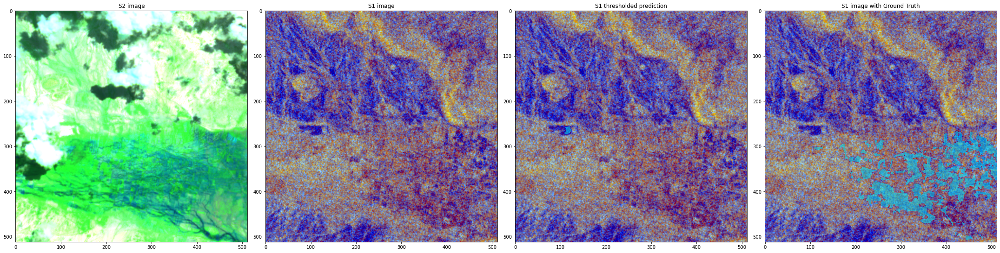

chips/e7d1917e-c069-45cf-a392-42e24aa2f4ac/s1/S1B_IW_GRDH_1SDV_20201020T164222_20201020T164247_023899_02D6C4_35D8_01536-00000/LabelWater.tif


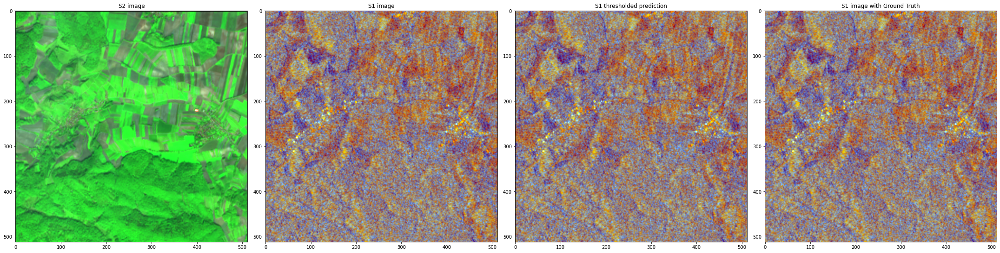

chips/d89b6d2c-ded5-463e-81cc-13c1764df616/s1/S1A_IW_GRDH_1SDV_20160812T234651_20160812T234716_012574_013B43_8C18_09997-04622/LabelWater.tif


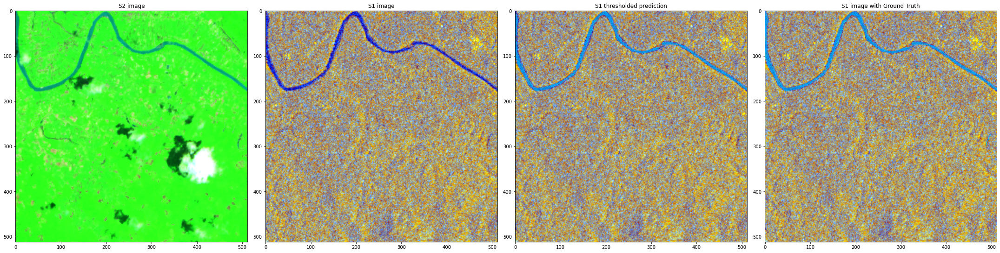

chips/dc70be79-da19-47ee-bdee-4614bc46d610/s1/S1A_IW_GRDH_1SDV_20180507T160449_20180507T160514_021800_025A09_6700_01536-05632/LabelWater.tif


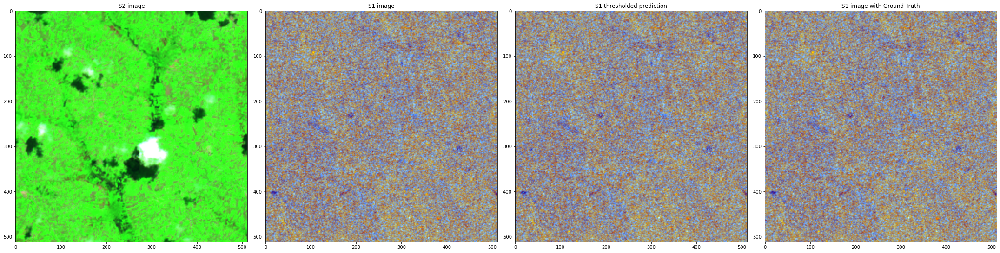

chips/d89b6d2c-ded5-463e-81cc-13c1764df616/s1/S1A_IW_GRDH_1SDV_20160812T234622_20160812T234651_012574_013B43_CFE9_05029-04930/LabelWater.tif


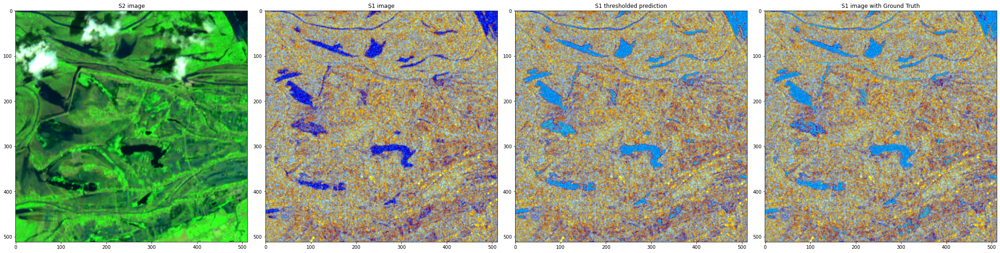

chips/f59da1a3-a2f1-45b8-b975-57af1b344252/s1/S1A_IW_GRDH_1SDV_20190522T002101_20190522T002126_027333_031530_0129_10275-00897/LabelWater.tif


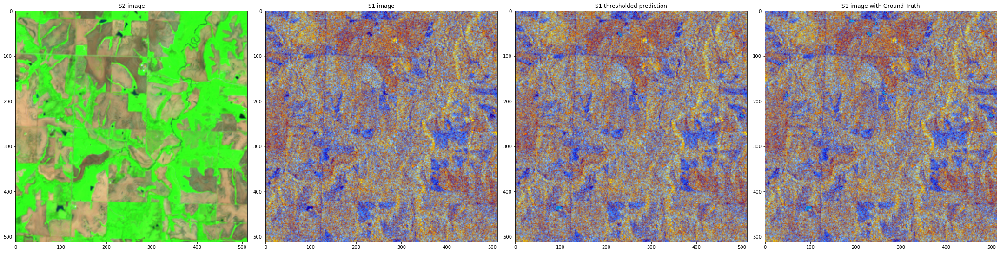

chips/89b504aa-e913-46ce-9d9f-b9c48ca9b602/s1/S1B_IW_GRDH_1SDV_20180215T095745_20180215T095810_009632_0115DE_7203_07056-08240/LabelWater.tif


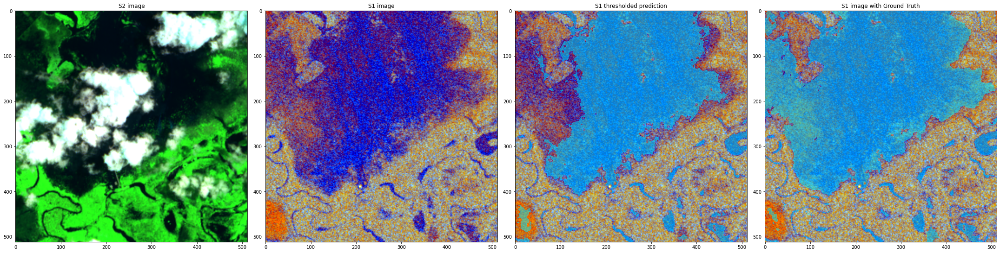

chips/f59da1a3-a2f1-45b8-b975-57af1b344252/s1/S1A_IW_GRDH_1SDV_20190522T002101_20190522T002126_027333_031530_0129_00439-00094/LabelWater.tif


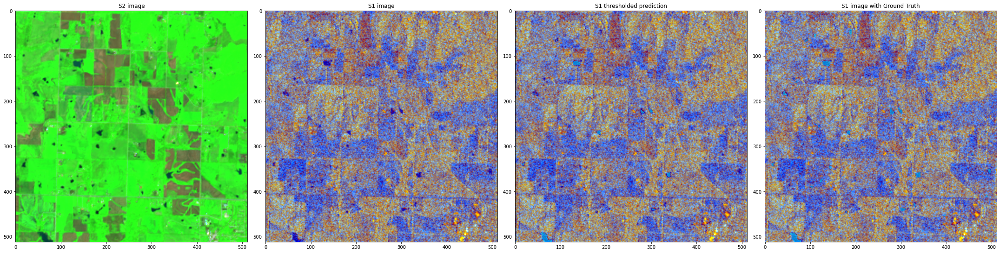

chips/55d43c77-9955-4b4f-b6f0-b21e7f50a039/s1/S1A_IW_GRDH_1SDV_20190404T002149_20190404T002214_026633_02FCE5_9FF0_04096-00000/LabelWater.tif


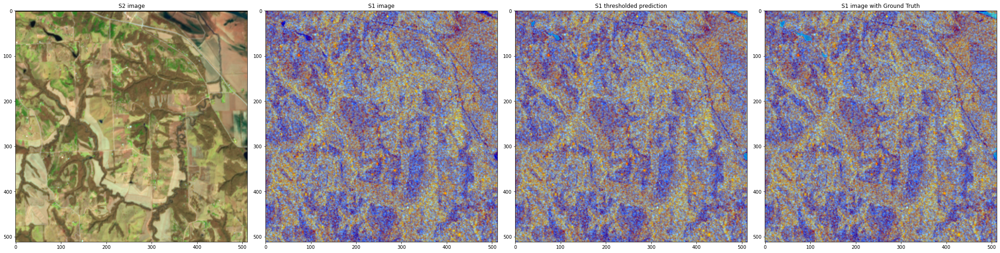

chips/e7d1917e-c069-45cf-a392-42e24aa2f4ac/s1/S1B_IW_GRDH_1SDV_20201020T164222_20201020T164247_023899_02D6C4_35D8_04608-04096/LabelWater.tif


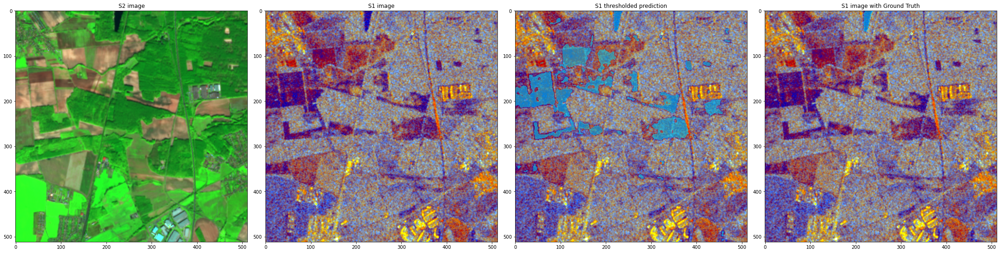

In [38]:
# plot random predictions vs ground truth
b_channels = ['B12', 'B7', 'B4']

show_how_many = 10
alpha = 0.5
for k in range(show_how_many):
    rand_int = np.random.randint(len(test_dataset))
    S1_label_path = test_dataset.mask_paths[rand_int]
    S1_VV_path = test_dataset.img_paths[rand_int][0]
    S1_VH_path = test_dataset.img_paths[rand_int][1]
    
    flood_event = S1_label_path.split("/")[1]
    position = S1_label_path.split("/")[-2].split("_")[-1]
    
    S2_label_path = glob.glob(f"chips/{flood_event}/s2/*{position}/LabelWater.tif")[0]
    S2_bands_paths = [S2_label_path.replace("LabelWater.tif", f"{channel}.tif") for channel in b_channels]
    
    f, axarr = plt.subplots(1, 4, figsize=(30, 10))
    print(S1_label_path)
    s1_img = visualize_s1_img(S1_VV_path, S1_VH_path)
    axarr[1].imshow(s1_img)
    axarr[1].set_title("S1 image")
    s2_img = visualize_s2_img(S2_bands_paths)
    axarr[2].imshow(s1_img)
    axarr[2].set_title("S1 thresholded prediction")
    axarr[3].imshow(s1_img)
    axarr[3].set_title("S1 image with Ground Truth")
    
    axarr[0].imshow(s2_img)
    axarr[0].set_title("S2 image")
         
    pred = probs[rand_int]
    pred = np.ma.masked_where(pred == 0, pred)
    axarr[2].imshow(pred, cmap="cool", alpha=alpha)
    
    label = tifffile.imread(S1_label_path)
    label = np.ma.masked_where(label == 0, label)
    axarr[3].imshow(label, cmap="cool", alpha=alpha)
    
    plt.tight_layout()
    plt.show()